# This notebook aims to look at eviction rates and socioeconomic characteristics across Los Angeles using Social Vulnerability Index data and Controller's data on Evictions in 2023

## First we will import packages that we will need to manipulate our data

In [57]:
import pandas as pd 
import geopandas as gpd
import plotly.express as px
import numpy as np
import matplotlib.pyplot as plt
import re
import folium as fm


## Part 1: Exploration of Housing Characteristics and Ownership across LA Neighborhoods and Census Tracts

This section focuses on analyzing housing characteristics and ownership trends across Los Angeles neighborhoods and census tracts. By exploring datasets containing information on housing types, construction years, and ownership rates, we aim to gain insights into the distribution and evolution of housing patterns in the area.

### Downloading Data
We upload and read two datasets namely LA_Times_Neighborhood_Boundaries geojson file and HousingData_Data csv file.

In [58]:
# Data on neighborhoods of LA
neighborhoods = gpd.read_file('data/LA_Times_Neighborhood_Boundaries.geojson')
# Data on housing characteristics
housing=pd.read_csv('data/HousingData_Data.csv')

/var/folders/6m/h91b_7rn0556n1htz41z92g00000gn/T/ipykernel_46277/2537522649.py:4: DtypeWarning: Columns (2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383) have mixed types. Specify dtype option on im

### Cleaning up Data
The Housing dataset contains variables that we do not need, so we will create a subset of variables and rename them. We will also match the GEO ID to FIPS and change the data types to the appropriate type.

In [59]:
# We look at the first 5 rows of data.
housing.head()

,GEO_ID,NAME,S2504_C01_001E,S2504_C01_001M,S2504_C01_002E,S2504_C01_002M,S2504_C01_003E,S2504_C01_003M,S2504_C01_004E,S2504_C01_004M,...,S2504_C06_034M,S2504_C06_035E,S2504_C06_035M,S2504_C06_036E,S2504_C06_036M,S2504_C06_037E,S2504_C06_037M,S2504_C06_038E,S2504_C06_038M,Unnamed: 458
0,Geography,Geographic Area Name,Estimate!!Occupied housing units!!Occupied hou...,Margin of Error!!Occupied housing units!!Occup...,Estimate!!Occupied housing units!!Occupied hou...,Margin of Error!!Occupied housing units!!Occup...,Estimate!!Occupied housing units!!Occupied hou...,Margin of Error!!Occupied housing units!!Occup...,Estimate!!Occupied housing units!!Occupied hou...,Margin of Error!!Occupied housing units!!Occup...,...,Margin of Error!!Percent renter-occupied housi...,Estimate!!Percent renter-occupied housing unit...,Margin of Error!!Percent renter-occupied housi...,Estimate!!Percent renter-occupied housing unit...,Margin of Error!!Percent renter-occupied housi...,Estimate!!Percent renter-occupied housing unit...,Margin of Error!!Percent renter-occupied housi...,Estimate!!Percent renter-occupied housing unit...,Margin of Error!!Percent renter-occupied housi...,NaN
1,0400000US06,California,13315822,16341,7717602,20881,974967,8559,307146,4418,...,0.2,0.2,0.1,0.0,0.1,1.2,0.1,5.2,0.1,NaN
2,0500000US06037,"Los Angeles County, California",3363093,4811,1641295,7223,217829,3694,87715,2323,...,0.3,0.1,0.1,0.0,0.1,0.4,0.1,8.4,0.2,NaN
3,1400000US06037101110,Census Tract 1011.10; Los Angeles County; Cali...,1551,130,976,129,38,32,84,68,...,11.5,0.0,5.5,0.0,5.5,0.0,5.5,2.0,3.3,NaN
4,1400000US06037101122,Census Tract 1011.22; Los Angeles County; Cali...,1383,160,1316,167,0,13,33,43,...,13.0,0.0,11.0,0.0,11.0,0.0,11.0,0.0,11.0,NaN


In [60]:
#We delete the first 9 digits of GEO ID to match with FIPS
housing['GEO_ID'] = housing['GEO_ID'].str[9:]

#We rename the "Geo ID" variable to "Geo FIPS"
housing = housing.rename(columns={'GEO_ID': 'Geo_FIPS'})
housing

,Geo_FIPS,NAME,S2504_C01_001E,S2504_C01_001M,S2504_C01_002E,S2504_C01_002M,S2504_C01_003E,S2504_C01_003M,S2504_C01_004E,S2504_C01_004M,...,S2504_C06_034M,S2504_C06_035E,S2504_C06_035M,S2504_C06_036E,S2504_C06_036M,S2504_C06_037E,S2504_C06_037M,S2504_C06_038E,S2504_C06_038M,Unnamed: 458
0,,Geographic Area Name,Estimate!!Occupied housing units!!Occupied hou...,Margin of Error!!Occupied housing units!!Occup...,Estimate!!Occupied housing units!!Occupied hou...,Margin of Error!!Occupied housing units!!Occup...,Estimate!!Occupied housing units!!Occupied hou...,Margin of Error!!Occupied housing units!!Occup...,Estimate!!Occupied housing units!!Occupied hou...,Margin of Error!!Occupied housing units!!Occup...,...,Margin of Error!!Percent renter-occupied housi...,Estimate!!Percent renter-occupied housing unit...,Margin of Error!!Percent renter-occupied housi...,Estimate!!Percent renter-occupied housing unit...,Margin of Error!!Percent renter-occupied housi...,Estimate!!Percent renter-occupied housing unit...,Margin of Error!!Percent renter-occupied housi...,Estimate!!Percent renter-occupied housing unit...,Margin of Error!!Percent renter-occupied housi...,NaN
1,06,California,13315822,16341,7717602,20881,974967,8559,307146,4418,...,0.2,0.2,0.1,0.0,0.1,1.2,0.1,5.2,0.1,NaN
2,06037,"Los Angeles County, California",3363093,4811,1641295,7223,217829,3694,87715,2323,...,0.3,0.1,0.1,0.0,0.1,0.4,0.1,8.4,0.2,NaN
3,06037101110,Census Tract 1011.10; Los Angeles County; Cali...,1551,130,976,129,38,32,84,68,...,11.5,0.0,5.5,0.0,5.5,0.0,5.5,2.0,3.3,NaN
4,06037101122,Census Tract 1011.22; Los Angeles County; Cali...,1383,160,1316,167,0,13,33,43,...,13.0,0.0,11.0,0.0,11.0,0.0,11.0,0.0,11.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2496,06037980038,Census Tract 9800.38; Los Angeles County; Cali...,0,13,0,13,0,13,0,13,...,**,-,**,-,**,-,**,-,**,NaN
2497,06037980039,Census Tract 9800.39; Los Angeles County; Cali...,0,13,0,13,0,13,0,13,...,**,-,**,-,**,-,**,-,**,NaN
2498,06037990100,Census Tract 9901; Los Angeles County; California,0,13,0,13,0,13,0,13,...,**,-,**,-,**,-,**,-,**,NaN
2499,06037990200,Census Tract 9902; Los Angeles County; California,0,13,0,13,0,13,0,13,...,**,-,**,-,**,-,**,-,**,NaN


In [61]:
#columns to keep in Housing Dataset
columns_to_keep= [
'Geo_FIPS',
'NAME',
'S2504_C01_001E',
'S2504_C02_001E',
'S2504_C05_001E',
'S2504_C06_001E',
'S2504_C03_001E',
'S2504_C04_002E',]

#add to new dataframe
housing2=housing[columns_to_keep]

# Renaming columns
housing2.columns = ['FIPS',
'NAME',
'Est_Total_Occupied',
'Percent_Total_Ocupied',
'Est_Renter_Occupied',
'Percent_Renter_Occupied',
'Est_Owner_Occupied',
'Percent_Owner_Occupied',] 

In [62]:
# Drop rows, the first 3 rows are not needed 
rows_to_delete = [0, 1, 2]
housing2 = housing2.drop(rows_to_delete)

In [63]:
# See data types
housing2.info (verbose=True, show_counts= True) 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2498 entries, 3 to 2500
Data columns (total 8 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   FIPS                     2498 non-null   object
 1   NAME                     2498 non-null   object
 2   Est_Total_Occupied       2498 non-null   object
 3   Percent_Total_Ocupied    2498 non-null   object
 4   Est_Renter_Occupied      2498 non-null   object
 5   Percent_Renter_Occupied  2498 non-null   object
 6   Est_Owner_Occupied       2498 non-null   object
 7   Percent_Owner_Occupied   2498 non-null   object
dtypes: object(8)
memory usage: 156.3+ KB


### Converting variables
All of our variables are labeled as objects. However, variables like etimates and the percents should be integers and floats, respectively, as these are numerical values. We are convert them to represent this.

In [64]:
# Separate specific columns for integer
columns_to_convert_int = ['Est_Total_Occupied', 'Est_Renter_Occupied', 'Est_Owner_Occupied']
# Convert to integer
housing2[columns_to_convert_int] = housing2[columns_to_convert_int].astype(int)

# Separate specific columns for percent
columns_to_convert_float = ['Percent_Total_Ocupied', 'Percent_Renter_Occupied', 'Percent_Owner_Occupied']
# Replace non-numeric values with NaN
housing2[columns_to_convert_float] = housing2[columns_to_convert_float].replace('-', np.nan)
# Convert to float for decimal
housing2[columns_to_convert_float] = housing2[columns_to_convert_float].astype(float) 

In [65]:
# Check the work again
housing2.info (verbose=True, show_counts= True) 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2498 entries, 3 to 2500
Data columns (total 8 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   FIPS                     2498 non-null   object 
 1   NAME                     2498 non-null   object 
 2   Est_Total_Occupied       2498 non-null   int64  
 3   Percent_Total_Ocupied    2498 non-null   float64
 4   Est_Renter_Occupied      2498 non-null   int64  
 5   Percent_Renter_Occupied  2498 non-null   float64
 6   Est_Owner_Occupied       2498 non-null   int64  
 7   Percent_Owner_Occupied   2428 non-null   float64
dtypes: float64(3), int64(3), object(2)
memory usage: 156.3+ KB


In [66]:
# We look at the first 5 rows of data.
housing2.head()

,FIPS,NAME,Est_Total_Occupied,Percent_Total_Ocupied,Est_Renter_Occupied,Percent_Renter_Occupied,Est_Owner_Occupied,Percent_Owner_Occupied
3,06037101110,Census Tract 1011.10; Los Angeles County; Cali...,1551,1551.0,711,711.0,840,90.8
4,06037101122,Census Tract 1011.22; Los Angeles County; Cali...,1383,1383.0,344,344.0,1039,99.2
5,06037101220,Census Tract 1012.20; Los Angeles County; Cali...,1349,1349.0,767,767.0,582,91.6
6,06037101221,Census Tract 1012.21; Los Angeles County; Cali...,1424,1424.0,1077,1077.0,347,40.6
7,06037101222,Census Tract 1012.22; Los Angeles County; Cali...,928,928.0,897,897.0,31,22.6


### After looking at the data, it looks like the value for the percent is wrong. We create a new variable to standardize the percent value for percent renter and percent owner occupied housing.

In [67]:
# Calculate percent renter-occupied

housing2['Calculated_Percent_Renter_Occupied'] = (housing2['Est_Renter_Occupied'] / housing2['Est_Total_Occupied']) * 100

# Calculate percent owner-occupied
housing2['Calculated_Percent_Owner_Occupied'] = (housing2['Est_Owner_Occupied'] / housing2['Est_Total_Occupied']) * 100


In [68]:
# Remove original percentage columns
housing2.drop(['Percent_Renter_Occupied', 'Percent_Owner_Occupied'], axis=1, inplace=True)


In [69]:
# We look at the first 5 rows of data
housing2.head()

,FIPS,NAME,Est_Total_Occupied,Percent_Total_Ocupied,Est_Renter_Occupied,Est_Owner_Occupied,Calculated_Percent_Renter_Occupied,Calculated_Percent_Owner_Occupied
3,06037101110,Census Tract 1011.10; Los Angeles County; Cali...,1551,1551.0,711,840,45.841393,54.158607
4,06037101122,Census Tract 1011.22; Los Angeles County; Cali...,1383,1383.0,344,1039,24.873463,75.126537
5,06037101220,Census Tract 1012.20; Los Angeles County; Cali...,1349,1349.0,767,582,56.856931,43.143069
6,06037101221,Census Tract 1012.21; Los Angeles County; Cali...,1424,1424.0,1077,347,75.632022,24.367978
7,06037101222,Census Tract 1012.22; Los Angeles County; Cali...,928,928.0,897,31,96.659483,3.340517


### Create a map showing owner-occupied and renter-occupied housing based on LA County Neighborhood Boundaries

In [70]:
# Merge datasets (housing data and neighborhood boundaries
housing_merged = neighborhoods.merge(housing2,left_index=True,right_index=True)

In [71]:
#Create Choropleth Map
m = fm.Map(location=[34.052235, -118.243683], zoom_start=10)  # Los Angeles coordinates

# Add Choropleth layer for owner-occupied housing
fm.Choropleth(
    geo_data=housing_merged,
    name='Owner Occupied Housing',
    data=housing_merged,
    columns=['FIPS', 'Calculated_Percent_Owner_Occupied'],
    key_on='feature.properties.FIPS',
    fill_color= 'YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Owner Occupied Housing (%)'
).add_to(m)

# Add Choropleth layer for renter-occupied housing
fm.Choropleth(
    geo_data=housing_merged,
    name='Renter Occupied Housing',
    data=housing_merged,
    columns=['FIPS', 'Calculated_Percent_Renter_Occupied'],
    key_on='feature.properties.FIPS',
    fill_color= 'PuBu',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Renter Occupied Housing (%)'
).add_to(m)

# Display the map
m.save('data/ownership_map.html')


### Trying a new map for a clearer visualization of where renters vs homeowners are
The map we created does not make a clear distinction between renters and homeowners. Since these counties contain both, the colors are muddy. We distinguish the two layers to make it clearer

In [72]:
# Add Layer Control to toggle between maps
fm.LayerControl().add_to(m)

# Display the map
m

#Save as new map
m.save('data/new_ownership_map.html')

### Using Census Tract Data 
Like the map on homeownership based on LA Neighborhoods, we are going to see where the proportion of renters are based on LA Census Tracts. The census tracts provides a standard to compare. 

In [73]:
# read Census_Tracts_2020 geojson file 
tracts=gpd.read_file('data/Census_Tracts_2020.geojson')
tracts.head()

,OBJECTID,CT20,LABEL,ShapeSTArea,ShapeSTLength,geometry
0,1,101110,1011.10,1.229562e+07,15083.854287,"POLYGON ((-118.28491 34.25948, -118.28492 34.2..."
1,2,101122,1011.22,2.845774e+07,31671.455844,"POLYGON ((-118.29015 34.27417, -118.29015 34.2..."
2,3,101220,1012.20,7.522093e+06,12698.783810,"POLYGON ((-118.28100 34.25592, -118.28198 34.2..."
3,4,101221,1012.21,3.812000e+06,9161.710543,"POLYGON ((-118.28735 34.25591, -118.28863 34.2..."
4,5,101222,1012.22,3.191371e+06,9980.600461,"POLYGON ((-118.28594 34.25405, -118.28594 34.2..."


In [74]:
# Subsetting the data to get FIPS and geometry
tracts = tracts[['CT20','geometry']]
tracts.head()

,CT20,geometry
0,101110,"POLYGON ((-118.28491 34.25948, -118.28492 34.2..."
1,101122,"POLYGON ((-118.29015 34.27417, -118.29015 34.2..."
2,101220,"POLYGON ((-118.28100 34.25592, -118.28198 34.2..."
3,101221,"POLYGON ((-118.28735 34.25591, -118.28863 34.2..."
4,101222,"POLYGON ((-118.28594 34.25405, -118.28594 34.2..."


In [75]:
# Creating a FIPS column 
tracts['FIPS'] ='06' + '037' + tracts['CT20']
tracts.head()

,CT20,geometry,FIPS
0,101110,"POLYGON ((-118.28491 34.25948, -118.28492 34.2...",06037101110
1,101122,"POLYGON ((-118.29015 34.27417, -118.29015 34.2...",06037101122
2,101220,"POLYGON ((-118.28100 34.25592, -118.28198 34.2...",06037101220
3,101221,"POLYGON ((-118.28735 34.25591, -118.28863 34.2...",06037101221
4,101222,"POLYGON ((-118.28594 34.25405, -118.28594 34.2...",06037101222


In [76]:
# Merging the dataframe containg housing characteristics with the dataframe previouly imported.
tracts_housing=tracts.merge(housing2,on="FIPS")

In [77]:
#Checking to see if the two data frames have been merged
tracts_housing.head()

,CT20,geometry,FIPS,NAME,Est_Total_Occupied,Percent_Total_Ocupied,Est_Renter_Occupied,Est_Owner_Occupied,Calculated_Percent_Renter_Occupied,Calculated_Percent_Owner_Occupied
0,101110,"POLYGON ((-118.28491 34.25948, -118.28492 34.2...",06037101110,Census Tract 1011.10; Los Angeles County; Cali...,1551,1551.0,711,840,45.841393,54.158607
1,101122,"POLYGON ((-118.29015 34.27417, -118.29015 34.2...",06037101122,Census Tract 1011.22; Los Angeles County; Cali...,1383,1383.0,344,1039,24.873463,75.126537
2,101220,"POLYGON ((-118.28100 34.25592, -118.28198 34.2...",06037101220,Census Tract 1012.20; Los Angeles County; Cali...,1349,1349.0,767,582,56.856931,43.143069
3,101221,"POLYGON ((-118.28735 34.25591, -118.28863 34.2...",06037101221,Census Tract 1012.21; Los Angeles County; Cali...,1424,1424.0,1077,347,75.632022,24.367978
4,101222,"POLYGON ((-118.28594 34.25405, -118.28594 34.2...",06037101222,Census Tract 1012.22; Los Angeles County; Cali...,928,928.0,897,31,96.659483,3.340517


In [78]:
"""
#Plot proportion of renter occupied housing
tracts_housing.plot(figsize=(12,10),
                 column='Calculated_Percent_Renter_Occupied',
                 legend=True, 
                 scheme='NaturalBreaks')
                 """

"\n#Plot proportion of renter occupied housing\ntracts_housing.plot(figsize=(12,10),\n                 column='Calculated_Percent_Renter_Occupied',\n                 legend=True, \n                 scheme='NaturalBreaks')\n                 "

## Part 2: Understanding housing trends over time, especially for variables related to housing construction years.

For this new set of data analysis, we will start by cleaning the data set to focus on other housing characteristics for temporal analysis. 

### Cleaning the data set

In [79]:
# separate columns
columns_to_keep = ['S2504_C01_001E',
'S2504_C01_009E', 
'S2504_C01_010E',
'S2504_C01_011E',
'S2504_C05_001E',
'S2504_C05_009E',
'S2504_C05_010E',
'S2504_C05_011E', 
'S2504_C03_001E',
'S2504_C03_009E',
'S2504_C03_010E',
'S2504_C03_011E',]

#add to new dataframe
housing_built=housing[columns_to_keep]

# Renaming columns
housing_built.columns = ['Total_Occupied',
'Recently_Built',
'Built_2010_2019',
'Built_2000_2009',
'Renter_Occupied',
'Recent_Rentals',
'Rentals_2010_2019', 
'Rentals_2000_2009',                       
'Owner_Occupied',
'Recent_Owners',
'Owners_2010_2019', 
'Owners_2000_2009']           

In [80]:
#Check the data types
housing_built.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2501 entries, 0 to 2500
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Total_Occupied     2501 non-null   object
 1   Recently_Built     2501 non-null   object
 2   Built_2010_2019    2501 non-null   object
 3   Built_2000_2009    2501 non-null   object
 4   Renter_Occupied    2501 non-null   object
 5   Recent_Rentals     2501 non-null   object
 6   Rentals_2010_2019  2501 non-null   object
 7   Rentals_2000_2009  2501 non-null   object
 8   Owner_Occupied     2501 non-null   object
 9   Recent_Owners      2501 non-null   object
 10  Owners_2010_2019   2501 non-null   object
 11  Owners_2000_2009   2501 non-null   object
dtypes: object(12)
memory usage: 234.6+ KB


In [81]:
# We look at the first 5 rows of data.
housing_built.head()

,Total_Occupied,Recently_Built,Built_2010_2019,Built_2000_2009,Renter_Occupied,Recent_Rentals,Rentals_2010_2019,Rentals_2000_2009,Owner_Occupied,Recent_Owners,Owners_2010_2019,Owners_2000_2009
0,Estimate!!Occupied housing units!!Occupied hou...,Estimate!!Occupied housing units!!Occupied hou...,Estimate!!Occupied housing units!!Occupied hou...,Estimate!!Occupied housing units!!Occupied hou...,Estimate!!Renter-occupied housing units!!Occup...,Estimate!!Renter-occupied housing units!!Occup...,Estimate!!Renter-occupied housing units!!Occup...,Estimate!!Renter-occupied housing units!!Occup...,Estimate!!Owner-occupied housing units!!Occupi...,Estimate!!Owner-occupied housing units!!Occupi...,Estimate!!Owner-occupied housing units!!Occupi...,Estimate!!Owner-occupied housing units!!Occupi...
1,13315822,49182,733592,1467744,5908461,18002,359968,532383,7407361,31180,373624,935361
2,3363093,8191,126799,182907,1810929,5007,86061,93920,1552164,3184,40738,88987
3,1551,0,39,48,711,0,9,0,840,0,30,48
4,1383,0,5,222,344,0,0,78,1039,0,5,144


In [82]:
# Drop rows by index
rows_to_delete = [0, 1, 2]
housing_built = housing_built.drop(rows_to_delete)

In [83]:
# Convert columns to integer data type
housing_built = housing_built.astype({col: 'int' for col in housing_built.columns})

In [84]:
#Check the data types
housing_built.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2498 entries, 3 to 2500
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype
---  ------             --------------  -----
 0   Total_Occupied     2498 non-null   int64
 1   Recently_Built     2498 non-null   int64
 2   Built_2010_2019    2498 non-null   int64
 3   Built_2000_2009    2498 non-null   int64
 4   Renter_Occupied    2498 non-null   int64
 5   Recent_Rentals     2498 non-null   int64
 6   Rentals_2010_2019  2498 non-null   int64
 7   Rentals_2000_2009  2498 non-null   int64
 8   Owner_Occupied     2498 non-null   int64
 9   Recent_Owners      2498 non-null   int64
 10  Owners_2010_2019   2498 non-null   int64
 11  Owners_2000_2009   2498 non-null   int64
dtypes: int64(12)
memory usage: 234.3 KB


### Creating a Bar graph that will show Estimated Total Occupied Housing Built in Different Years

Our analysis show that Year 2000 to 2009 has the most total housing occupied units in LA County,followed by units constructed in 2010-2019. The Year 2020 and later has the least number of total occupied housing units. 

In [85]:
# Extracting relevant columns for total occupied housing
years = ['2020 or later', '2010-2019', '2000-2009']
total_counts = [
    housing_built['Recently_Built'].sum(),
    housing_built['Built_2010_2019'].sum(),
    housing_built['Built_2000_2009'].sum()
]

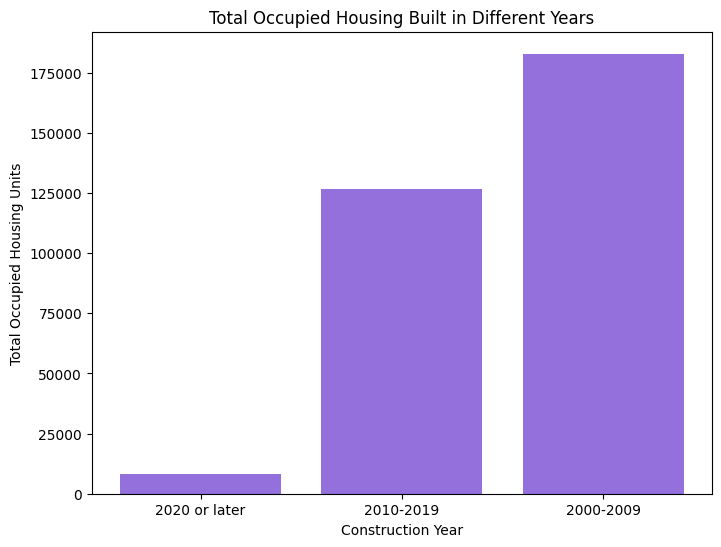

In [86]:
# Plotting the bar graph for total occupied housing
plt.figure(figsize=(8, 6))
plt.bar(years, total_counts, color='mediumpurple')
plt.title('Total Occupied Housing Built in Different Years')
plt.xlabel('Construction Year')
plt.ylabel('Total Occupied Housing Units')
plt.show()

Year 2000 to 2009 has the most total rented housing units followed by units constructed in 2010-2019. The houses built in the Year 2020 and later has the least amount of total rented housing units.

In [87]:
# Extracting relevant columns for renter occupied housing
years = ['2020 or later', '2010-2019', '2000-2009']
renter_counts = [
    housing_built['Recent_Rentals'].sum(),
    housing_built['Rentals_2010_2019'].sum(),
    housing_built['Rentals_2000_2009'].sum()
]

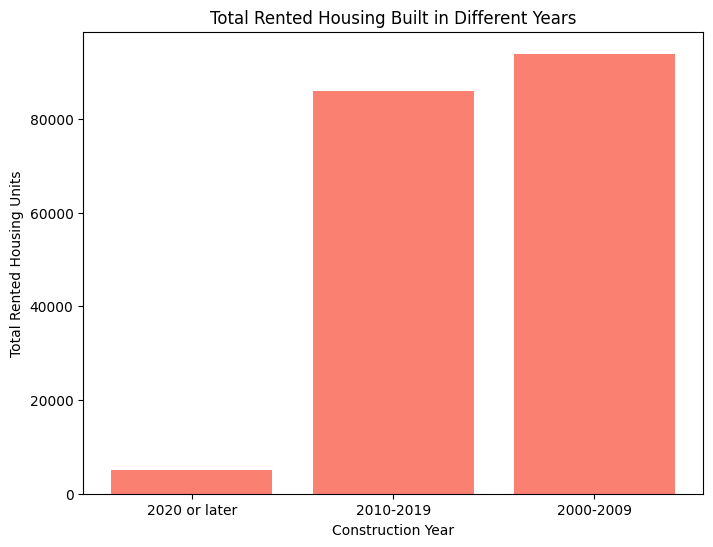

In [88]:
# Plotting the bar graph for renter occupied housing
plt.figure(figsize=(8, 6))
plt.bar(years, renter_counts, color='salmon')
plt.title('Total Rented Housing Built in Different Years')
plt.xlabel('Construction Year')
plt.ylabel('Total Rented Housing Units')
plt.show()

The owner occupied housing units analysis show that houses built in 2000 to 2009 has the most total owned housing units compared to houses built in 2010 to 2019 with almost half the total and 2020 and later has the least total number of owned housing units.  

In [89]:
# Extracting relevant columns for renter occupied housing
years = ['2020 or later', '2010-2019', '2000-2009']
owner_counts = [
    housing_built['Recent_Owners'].sum(),
    housing_built['Owners_2010_2019'].sum(),
    housing_built['Owners_2000_2009'].sum()
]

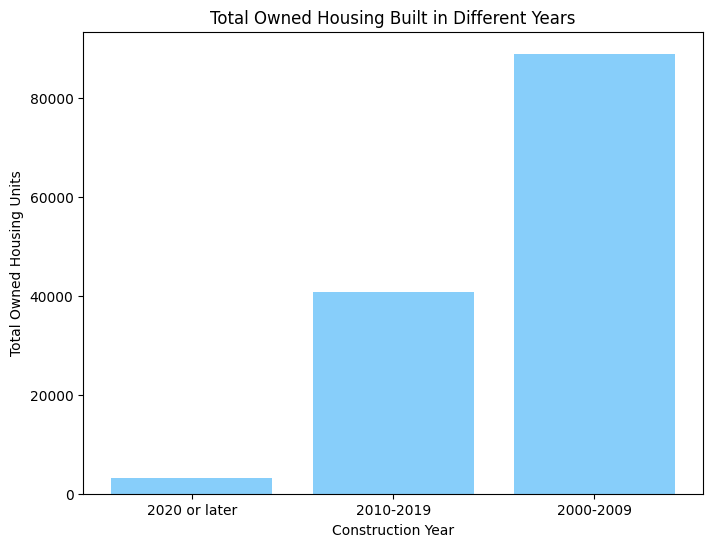

In [90]:
# Plotting the bar graph for owner occupied housing
plt.figure(figsize=(8, 6))
plt.bar(years, owner_counts, color='lightskyblue')
plt.title('Total Owned Housing Built in Different Years')
plt.xlabel('Construction Year')
plt.ylabel('Total Owned Housing Units')
plt.show()

### Plotting grouped bar chart
We want to plot a grouped bar chart for better comparison. We observe that in the three categories we looked houses built in 2000 to 2009 dominates in all categories namely total housing built, rented housing built, and owner occupied housing built. The year 2010 to 2019 takes second place in all categories and the last is year 2020 and later with least values in all three categories. This could be because newer houses tend to charge more than older buildings. 

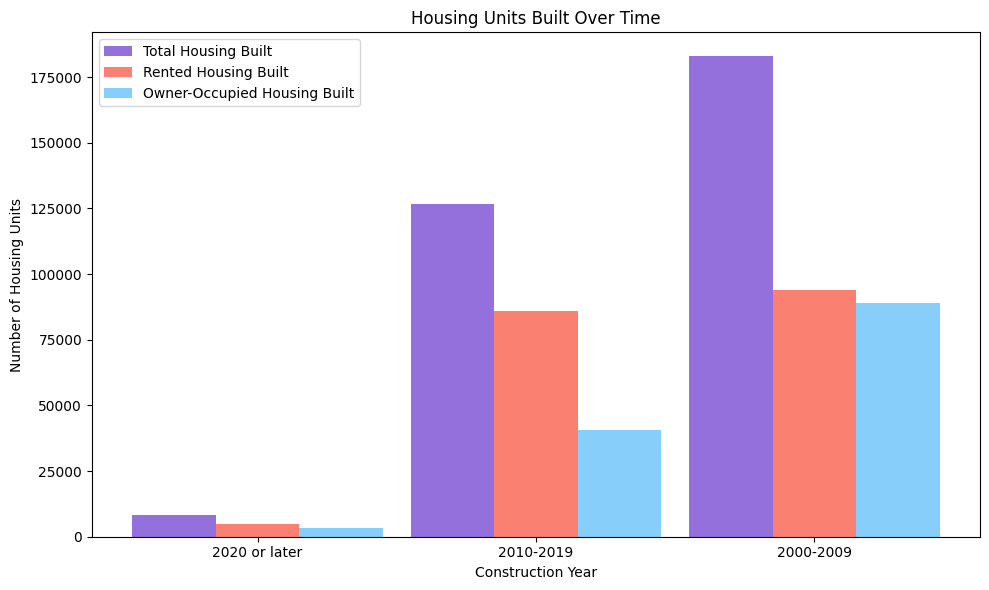

In [91]:
#define variables
years = ['2020 or later', '2010-2019', '2000-2009']
x = np.arange(len(years))
bar_width= 0.30

# Plotting grouped bar chart
plt.figure(figsize=(10, 6))

# Plotting bars for total housing built
plt.bar(x - bar_width, total_counts, width=bar_width, color='mediumpurple', label='Total Housing Built')

# Plotting bars for renter occupied housing
plt.bar(x, renter_counts, width=bar_width, color='salmon', label='Rented Housing Built')

# Plotting bars for owner occupied housing
plt.bar(x + bar_width, owner_counts, width=bar_width, color='lightskyblue', label='Owner-Occupied Housing Built')

# Adding labels, title, and legend
plt.xlabel('Construction Year')
plt.ylabel('Number of Housing Units')
plt.title('Housing Units Built Over Time')
plt.xticks(x, years)
plt.legend()

plt.tight_layout()
plt.show()

## Part 3: Exploring Eviction Data in LA 2023

The data we got from the LA Controller's office was large and not geocoded. We had to use Google's service and a handy bit of code from [this](https://www.shanelynn.ie/tag/geocoding/) website. This geocoded data alongside the Social Vulnerability Index dataset which pools together relevant ACS questions into one dataset served as the basis of our exploration. In this broad exploration, several questions arise that prompt further study. Rent burden, as you'll see for example, does not visually differ in meaningful ways between the census tracts with the highest and the lowest eviction filing rates. Other findings, like eviction filings by neighborhood, follow more predictable patterns

### Data Cleaning

####  We'll start by reading in the necessary files

In [92]:
# Importing Vunerability Index data
vul = gpd.read_file('data/LACountySVI.geojson') 

# Eviction data publically available from the LA Controller's Office
evictions = pd.read_csv('data/2023_eviction_filings_final.csv')

geoevictions = pd.read_csv('data/evictions_geocoded.csv')

#Neighborhood Boundaries
neighborhoods = gpd.read_file('data/LA_Times_Neighborhood_Boundaries.geojson')

#### Some preliminary data visualization

In [93]:
evictions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 77091 entries, 0 to 77090
Data columns (total 10 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Notice Date        77085 non-null  object 
 1   Date Received      77091 non-null  object 
 2   Eviction Category  77091 non-null  object 
 3   Cause              77089 non-null  object 
 4   Address            77091 non-null  object 
 5   Bedroom            65224 non-null  float64
 6   Notice Type        77091 non-null  object 
 7   Apn                77091 non-null  int64  
 8   Council District   77091 non-null  int64  
 9   Rent Owed          77091 non-null  object 
dtypes: float64(1), int64(2), object(7)
memory usage: 5.9+ MB


In [94]:
geoevictions.head()

,Unnamed: 0,formatted_address,latitude,longitude,accuracy,google_place_id,type,postcode,input_string,number_of_results,status
0,0,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046.0,"7367 Hollywood Blvd, Los Angeles, 90046",1,OK
1,1,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046.0,"7367 Hollywood Blvd, Los Angeles, 90046",1,OK
2,2,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046.0,"7367 Hollywood Blvd, Los Angeles, 90046",1,OK
3,3,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046.0,"7367 Hollywood Blvd, Los Angeles, 90046",1,OK
4,4,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046.0,"7367 Hollywood Blvd, Los Angeles, 90046",1,OK


#### We'll rename the 'formatted_address' column to 'Address'

In [95]:
geoevictions = geoevictions.rename(columns={'formatted_address': 'Address'})

In [96]:
geoevictions.head()

,Unnamed: 0,Address,latitude,longitude,accuracy,google_place_id,type,postcode,input_string,number_of_results,status
0,0,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046.0,"7367 Hollywood Blvd, Los Angeles, 90046",1,OK
1,1,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046.0,"7367 Hollywood Blvd, Los Angeles, 90046",1,OK
2,2,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046.0,"7367 Hollywood Blvd, Los Angeles, 90046",1,OK
3,3,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046.0,"7367 Hollywood Blvd, Los Angeles, 90046",1,OK
4,4,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046.0,"7367 Hollywood Blvd, Los Angeles, 90046",1,OK


####  Let's merge the eviction data from the Controller's office with the geocoded data we got from the Google API

In [97]:
mergedevictions = geoevictions.merge(evictions,left_index=True,right_index=True)


#### Now we want to see that our datasets were merged successfully

In [98]:
mergedevictions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 77091 entries, 0 to 77090
Data columns (total 21 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Unnamed: 0         77091 non-null  int64  
 1   Address_x          76760 non-null  object 
 2   latitude           76760 non-null  float64
 3   longitude          76760 non-null  float64
 4   accuracy           76760 non-null  object 
 5   google_place_id    76760 non-null  object 
 6   type               76760 non-null  object 
 7   postcode           76458 non-null  float64
 8   input_string       77091 non-null  object 
 9   number_of_results  77091 non-null  int64  
 10  status             77091 non-null  object 
 11  Notice Date        77085 non-null  object 
 12  Date Received      77091 non-null  object 
 13  Eviction Category  77091 non-null  object 
 14  Cause              77089 non-null  object 
 15  Address_y          77091 non-null  object 
 16  Bedroom            652

#### Now we'll convert postcode to int and rename it zipcode

In [99]:
mergedevictions = mergedevictions.rename(columns={'postcode': 'zipcode'})

In [100]:
mergedevictions['zipcode'] = mergedevictions['zipcode'].fillna(0).astype(int)

In [101]:
mergedevictions.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 77091 entries, 0 to 77090
Data columns (total 21 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Unnamed: 0         77091 non-null  int64  
 1   Address_x          76760 non-null  object 
 2   latitude           76760 non-null  float64
 3   longitude          76760 non-null  float64
 4   accuracy           76760 non-null  object 
 5   google_place_id    76760 non-null  object 
 6   type               76760 non-null  object 
 7   zipcode            77091 non-null  int64  
 8   input_string       77091 non-null  object 
 9   number_of_results  77091 non-null  int64  
 10  status             77091 non-null  object 
 11  Notice Date        77085 non-null  object 
 12  Date Received      77091 non-null  object 
 13  Eviction Category  77091 non-null  object 
 14  Cause              77089 non-null  object 
 15  Address_y          77091 non-null  object 
 16  Bedroom            652

In [102]:
mergedevictions.head()

,Unnamed: 0,Address_x,latitude,longitude,accuracy,google_place_id,type,zipcode,input_string,number_of_results,...,Notice Date,Date Received,Eviction Category,Cause,Address_y,Bedroom,Notice Type,Apn,Council District,Rent Owed
0,0,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046,"7367 Hollywood Blvd, Los Angeles, 90046",1,...,2/3/23,2/3/23,At-Fault,Non-payment of rent,"7367 Hollywood Blvd, Los Angeles, 90046",NaN,3 Day,5550001030,4,"$1,850.00"
1,1,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046,"7367 Hollywood Blvd, Los Angeles, 90046",1,...,2/3/23,2/3/23,At-Fault,Non-payment of rent,"7367 Hollywood Blvd, Los Angeles, 90046",NaN,3 Day,5550001030,4,"$1,866.78"
2,2,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046,"7367 Hollywood Blvd, Los Angeles, 90046",1,...,2/3/23,2/3/23,At-Fault,Non-payment of rent,"7367 Hollywood Blvd, Los Angeles, 90046",NaN,3 Day,5550001030,4,"$1,800.00"
3,3,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046,"7367 Hollywood Blvd, Los Angeles, 90046",1,...,2/3/23,2/3/23,At-Fault,Non-payment of rent,"7367 Hollywood Blvd, Los Angeles, 90046",NaN,3 Day,5550001030,4,"$1,500.00"
4,4,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046,"7367 Hollywood Blvd, Los Angeles, 90046",1,...,2/3/23,2/3/23,At-Fault,Non-payment of rent,"7367 Hollywood Blvd, Los Angeles, 90046",NaN,3 Day,5550001030,4,"$1,742.97"


#### Let's drop rows without coordinates and then convert to a Geopandas Dataframe

In [103]:
mergedevictions.dropna(subset=['latitude'], inplace=True)

In [104]:
geometry = gpd.points_from_xy(mergedevictions.longitude, mergedevictions.latitude)


In [105]:
mergedevictions = gpd.GeoDataFrame(mergedevictions, geometry=geometry)


In [106]:
mergedevictions.set_crs('EPSG:4326', inplace=True)


,Unnamed: 0,Address_x,latitude,longitude,accuracy,google_place_id,type,zipcode,input_string,number_of_results,...,Date Received,Eviction Category,Cause,Address_y,Bedroom,Notice Type,Apn,Council District,Rent Owed,geometry
0,0,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046,"7367 Hollywood Blvd, Los Angeles, 90046",1,...,2/3/23,At-Fault,Non-payment of rent,"7367 Hollywood Blvd, Los Angeles, 90046",NaN,3 Day,5550001030,4,"$1,850.00",POINT (-118.35071 34.10204)
1,1,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046,"7367 Hollywood Blvd, Los Angeles, 90046",1,...,2/3/23,At-Fault,Non-payment of rent,"7367 Hollywood Blvd, Los Angeles, 90046",NaN,3 Day,5550001030,4,"$1,866.78",POINT (-118.35071 34.10204)
2,2,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046,"7367 Hollywood Blvd, Los Angeles, 90046",1,...,2/3/23,At-Fault,Non-payment of rent,"7367 Hollywood Blvd, Los Angeles, 90046",NaN,3 Day,5550001030,4,"$1,800.00",POINT (-118.35071 34.10204)
3,3,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046,"7367 Hollywood Blvd, Los Angeles, 90046",1,...,2/3/23,At-Fault,Non-payment of rent,"7367 Hollywood Blvd, Los Angeles, 90046",NaN,3 Day,5550001030,4,"$1,500.00",POINT (-118.35071 34.10204)
4,4,"7367 Hollywood Blvd, Los Angeles, CA 90046, USA",34.102045,-118.350714,ROOFTOP,ChIJn1QsGN6-woAR-WqccvGcHyY,premise,90046,"7367 Hollywood Blvd, Los Angeles, 90046",1,...,2/3/23,At-Fault,Non-payment of rent,"7367 Hollywood Blvd, Los Angeles, 90046",NaN,3 Day,5550001030,4,"$1,742.97",POINT (-118.35071 34.10204)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
77086,77086,"3191 W 7th St, Los Angeles, CA 90005, USA",34.060021,-118.294547,ROOFTOP,ChIJ0xG0pX7HwoARBhnxd309GG0,premise,90005,"3191 W 7TH ST, Los Angeles, 90005",1,...,1/17/24,At-Fault,Non-payment of rent,"3191 W 7TH ST, Los Angeles, 90005",0.0,30 Day,5094007010,10,"$9,500.00",POINT (-118.29455 34.06002)
77087,77087,"3191 W 7th St, Los Angeles, CA 90005, USA",34.060021,-118.294547,ROOFTOP,ChIJ0xG0pX7HwoARBhnxd309GG0,premise,90005,"3191 W 7TH ST, Los Angeles, 90005",1,...,1/17/24,At-Fault,Non-payment of rent,"3191 W 7TH ST, Los Angeles, 90005",0.0,30 Day,5094007010,10,"$4,480.00",POINT (-118.29455 34.06002)
77088,77088,"11049 W Magnolia Blvd, North Hollywood, CA 916...",34.165119,-118.358224,RANGE_INTERPOLATED,EjUxMTA0OSBXIE1hZ25vbGlhIEJsdmQsIE5vcnRoIEhvbG...,street_address,91601,"11049 W MAGNOLIA BLVD, Los Angeles, 91601",1,...,1/18/24,At-Fault,Non-payment of rent,"11049 W MAGNOLIA BLVD, Los Angeles, 91601",0.0,3 Day,2350018078,2,"$2,800.00",POINT (-118.35822 34.16512)
77089,77089,"11049 W Magnolia Blvd, North Hollywood, CA 916...",34.165119,-118.358224,RANGE_INTERPOLATED,EjUxMTA0OSBXIE1hZ25vbGlhIEJsdmQsIE5vcnRoIEhvbG...,street_address,91601,"11049 W MAGNOLIA BLVD, Los Angeles, 91601",1,...,1/18/24,At-Fault,Non-payment of rent,"11049 W MAGNOLIA BLVD, Los Angeles, 91601",0.0,3 Day,2350018078,2,"$1,918.00",POINT (-118.35822 34.16512)


### Evictions over Time

For now we want to plot the evictions over time. So we'll convert Notice Date to datetime to be able to manipulate it easier.

In [107]:
mergedevictions['notice_date_dt'] = pd.to_datetime(mergedevictions['Notice Date'], format='%m/%d/%y')
mergedevictions['notice_date_dt']

0       2023-02-03
1       2023-02-03
2       2023-02-03
3       2023-02-03
4       2023-02-03
           ...    
77086   2023-12-07
77087   2023-12-07
77088   2023-10-17
77089   2023-04-14
77090   2023-11-01
Name: notice_date_dt, Length: 76760, dtype: datetime64[ns]

In [108]:
mergedevictions['notice_date_dt'], mergedevictions['Notice Date']

(0       2023-02-03
 1       2023-02-03
 2       2023-02-03
 3       2023-02-03
 4       2023-02-03
            ...    
 77086   2023-12-07
 77087   2023-12-07
 77088   2023-10-17
 77089   2023-04-14
 77090   2023-11-01
 Name: notice_date_dt, Length: 76760, dtype: datetime64[ns],
 0          2/3/23
 1          2/3/23
 2          2/3/23
 3          2/3/23
 4          2/3/23
            ...   
 77086     12/7/23
 77087     12/7/23
 77088    10/17/23
 77089     4/14/23
 77090     11/1/23
 Name: Notice Date, Length: 76760, dtype: object)

In [109]:
mergedevictions = mergedevictions[mergedevictions['notice_date_dt'].dt.year >= 2023 ]
mergedevictions['notice_date_dt'].max(), mergedevictions['notice_date_dt'].min()

(Timestamp('2023-12-31 00:00:00'), Timestamp('2023-01-01 00:00:00'))

In [110]:
address_count_grpd = mergedevictions.value_counts(['notice_date_dt']).reset_index(name='count')
address_count_grpd

,notice_date_dt,count
0,2023-03-08,1638
1,2023-04-05,1611
2,2023-04-06,1548
3,2023-05-04,1483
4,2023-04-07,1442
...,...,...
341,2023-12-25,1
342,2023-01-09,1
343,2023-01-08,1
344,2023-01-06,1


In [111]:
address_count_grpd_june = address_count_grpd[address_count_grpd['notice_date_dt'].dt.month == 6]
address_count_grpd_june

,notice_date_dt,count
5,2023-06-06,1405
10,2023-06-07,1169
21,2023-06-05,910
38,2023-06-08,606
54,2023-06-13,453
58,2023-06-09,433
65,2023-06-02,369
70,2023-06-14,316
83,2023-06-15,249
91,2023-06-12,235


In [112]:
# a simple bar chart, putting date on the x-axis
fig_date_june = px.bar(
    address_count_grpd_june,
    x='notice_date_dt',
    y='count',
    text='count',
    title='Eviction Filings in June 2023',
    labels = {'notice_date_dt':'Notice Date','count':'Number of Evictions'}
)

fig_date_year = px.bar(
    address_count_grpd,
    x = 'notice_date_dt',
    y='count',
    text='count',
    title='Eviction filings in 2023',
    labels = {'notice_date_dt':'Notice Date','count':'Number of Evictions'}
)
fig_date_june.show(),fig_date_year.show()

(None, None)

Our analysis show that most filings happen in the beginning of the month. Eviction numbers tend to decline rapidly after mid year, random/sharp declines we could not explain.

We move on and map are data. First a folium map looking at the number of people per census tract that pay more than 35% of the income on gross rent. 

### Top 10 Zip Codes by Eviction Filings

#### We are interested in looking at eviction rates at the zipcode level

####  First we will create a count for the evictions per zipcode

In [113]:
zipcode_counts = mergedevictions.groupby('zipcode').size()

In [114]:
zipcode_counts_df = zipcode_counts.reset_index(name='count')
# Need to remove the NA values that were changed to 0 and remove the aberrant one
zipcode_counts_df = zipcode_counts_df.drop(labels=[0,145])
zipcode_counts_df

,zipcode,count
1,90001,55
2,90002,99
3,90003,596
4,90004,1747
5,90005,2258
...,...,...
140,91745,6
141,91761,1
142,91801,23
143,92867,2


#### Now we will create the top 10 zipcodes with the counts of evictions 

In [115]:
top_10_zipcodes = zipcode_counts_df.sort_values('count', ascending=False).head(10)

In [116]:
top_10_zipcodes

,zipcode,count
27,90028,5096
34,90036,3719
14,90015,3197
123,91367,2653
13,90014,2587
11,90012,2410
5,90005,2258
16,90017,2151
134,91601,1900
19,90020,1849


In [117]:
fig = px.bar(
    top_10_zipcodes,
    x=top_10_zipcodes['zipcode'].astype(str),
    y='count',
    title='Top 10 Zip Codes with the Most Evictions',
    labels={
        'x':'Zip Codes',
        'count':'Number of Evictions'
    }
)
fig.show()

Zip code 90028 and 90036 has the most recorded eviction numbers in 2023. These zip codes belong to the city of Los Angeles and Hollywood.

### Top 10 Zip Codes by Combined Amount of Rent Owed

In [118]:
mergedevictions['Rent Owed'] = mergedevictions['Rent Owed'].apply(lambda x: float(x.replace('$', '').replace(',', '')))


/Users/jackfukushima/anaconda3/lib/python3.11/site-packages/geopandas/geodataframe.py:1525: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [119]:
mergedevictions.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 76747 entries, 0 to 77090
Data columns (total 23 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   Unnamed: 0         76747 non-null  int64         
 1   Address_x          76747 non-null  object        
 2   latitude           76747 non-null  float64       
 3   longitude          76747 non-null  float64       
 4   accuracy           76747 non-null  object        
 5   google_place_id    76747 non-null  object        
 6   type               76747 non-null  object        
 7   zipcode            76747 non-null  int64         
 8   input_string       76747 non-null  object        
 9   number_of_results  76747 non-null  int64         
 10  status             76747 non-null  object        
 11  Notice Date        76747 non-null  object        
 12  Date Received      76747 non-null  object        
 13  Eviction Category  76747 non-null  object        
 14  Cau

In [120]:
result = mergedevictions.groupby('zipcode').agg({'Rent Owed':'sum'}).reset_index()
result = result.drop(labels=[0,145])

In [121]:
top_zip_codes = result.sort_values(by='Rent Owed', ascending=False).head(10)

In [122]:
top_zip_codes

,zipcode,Rent Owed
27,90028,19600134.54
14,90015,13179153.79
34,90036,12785616.52
13,90014,10103198.25
123,91367,9423870.34
5,90005,8026608.34
12,90013,7828494.05
11,90012,7071907.77
134,91601,6893085.90
16,90017,6609030.47


In [123]:
fig = px.bar(
    top_zip_codes,
    x=top_zip_codes['zipcode'].astype(str),
    y='Rent Owed',
    labels={
        'x':'Zip Codes',
        'Rent Owed':'Total Amount of Rent Owed in Dollars'
    },
    title='Top 10 Zip Codes by Total Amount of Rent Owed'
)
fig.show()

Zip code 90028, 90015, and 90036 has the most recorded total amount of rent owed in 2023. These zip codes belong to the city of Los Angeles and Hollywood.

### Eviction Counts by Building


In [124]:
address_count = mergedevictions.value_counts('Address_x').reset_index(name='count')
address_count['Address_x'] = address_count['Address_x'].astype(str)

In [125]:
address_count

,Address_x,count
0,"325 W Adams Blvd, Los Angeles, CA 90007, USA",993
1,"123 S Figueroa St, Los Angeles, CA 90012, USA",621
2,"1600 Vine St, Los Angeles, CA 90028, USA",533
3,"21201 Kittridge St, Woodland Hills, CA 91303, USA",329
4,"600 S Spring St, Los Angeles, CA 90014, USA",314
...,...,...
13651,"409 56th St, Los Angeles, CA 90011, USA",1
13652,"4084 S Muirfield Rd, Los Angeles, CA 90008, USA",1
13653,"4079 Abourne Rd a, Los Angeles, CA 90008, USA",1
13654,"4078 Tujunga Ave, Studio City, CA 91604, USA",1


In [126]:
# I'm interested in seeing if there are particular buildings with high rates of evictions
fig = px.bar(
    address_count.head(10),
    x='Address_x',
    y='count',
    title='Top 10 Buildings with most Eviction Filings in 2023',
    labels={
        'formatted_address':'Addresses with eviction filings'
    },
    text='count'
)
fig.show()

We found this [article](https://www.latimes.com/california/story/2023-09-07/over-40-000-eviction-notices-have-gone-out-in-la-this-year-many-to-upscale-apartments) after we did all of this work and got sad, but at least we can do further analysis in future work. We are not sure what happened with 325 w Adams Blvd but it does not seem like an accurate count given that the article cites the address as having closer to ~300.

### Type of bedrooms with the highest evictions

In [127]:
mergedevictions = mergedevictions.dropna(subset=['Bedroom'])

In [128]:
mergedevictions.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 64906 entries, 822 to 77090
Data columns (total 23 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   Unnamed: 0         64906 non-null  int64         
 1   Address_x          64906 non-null  object        
 2   latitude           64906 non-null  float64       
 3   longitude          64906 non-null  float64       
 4   accuracy           64906 non-null  object        
 5   google_place_id    64906 non-null  object        
 6   type               64906 non-null  object        
 7   zipcode            64906 non-null  int64         
 8   input_string       64906 non-null  object        
 9   number_of_results  64906 non-null  int64         
 10  status             64906 non-null  object        
 11  Notice Date        64906 non-null  object        
 12  Date Received      64906 non-null  object        
 13  Eviction Category  64906 non-null  object        
 14  C

In [129]:

mergedevictions.loc[:,'Bedroom'] = mergedevictions.loc[:,'Bedroom'].astype(str).replace({
    '0.0': 'Studio',
    '1.0': 'One Bed',
    '2.0': 'Two Bed',
    '3.0': 'Three Bed',
    '4.0': 'Four Bed',
    '5.0': 'Five Bed',
    '6.0': 'Six Bedroom',
    '7.0': 'Seven Bedroom',
    '8.0': 'Eight Bedroom', 
    '9.0': 'Nine Bedroom'
})



/var/folders/6m/h91b_7rn0556n1htz41z92g00000gn/T/ipykernel_46277/2747242308.py:1: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '['Three Bed' 'One Bed' 'Studio' ... 'Studio' 'Studio' 'One Bed']' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.



#### Create a bar chart for bedroom types with the highest evictions

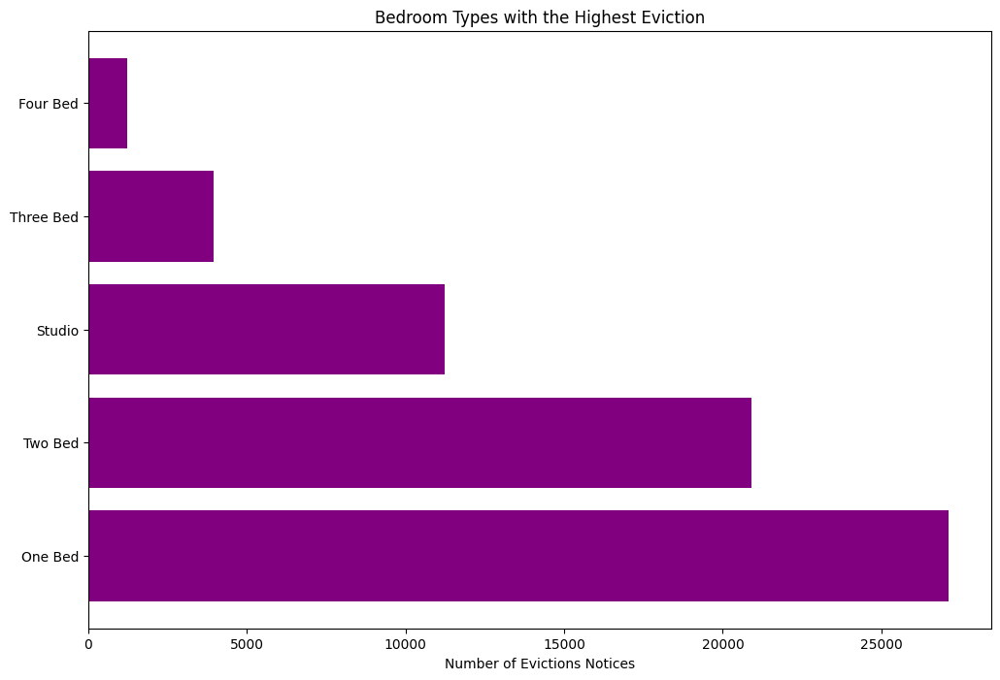

In [130]:
eviction_counts = mergedevictions['Bedroom'].value_counts()

bedroom_types = eviction_counts.index.tolist()

eviction_counts = eviction_counts.tolist()

plt.figure(figsize=(12,8))
plt.barh(bedroom_types[:5], eviction_counts[:5], color='purple')
plt.xlabel('Number of Evictions Notices')
plt.title('Bedroom Types with the Highest Eviction')
plt.show()

One bedroom had the most eviction notices followed by two bedroom and then studio. Four bedroom had the least number of eviction notices in LA county

### Eviction Filings by Cause for Filing of notice
Our analysis show that the dominant cause of eviction is non payment of rent and renter is usually at fault.

In [131]:
mergedevictions.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 64906 entries, 822 to 77090
Data columns (total 23 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   Unnamed: 0         64906 non-null  int64         
 1   Address_x          64906 non-null  object        
 2   latitude           64906 non-null  float64       
 3   longitude          64906 non-null  float64       
 4   accuracy           64906 non-null  object        
 5   google_place_id    64906 non-null  object        
 6   type               64906 non-null  object        
 7   zipcode            64906 non-null  int64         
 8   input_string       64906 non-null  object        
 9   number_of_results  64906 non-null  int64         
 10  status             64906 non-null  object        
 11  Notice Date        64906 non-null  object        
 12  Date Received      64906 non-null  object        
 13  Eviction Category  64906 non-null  object        
 14  C

In [132]:
mergedevictions.Cause.value_counts()


Cause
Non-payment of rent                                                                                                                                                                                                                     60667
Violation of the rental agreement or lease                                                                                                                                                                                               1315
Non-payment of rent, Violation of the rental agreement or lease                                                                                                                                                                           858
Violation of the rental agreement or lease, Disorderly behavior/disturbing the peace (Nuisance)                                                                                                                                           363
Disorderly behavior/disturbing the peace (

In [133]:
mergedevictions['Cause'].fillna(False)
mergedevictionsvio = mergedevictions[mergedevictions['Cause'].str.fullmatch('Non-payment of rent', na=False)]
mergedevictionsvio

,Unnamed: 0,Address_x,latitude,longitude,accuracy,google_place_id,type,zipcode,input_string,number_of_results,...,Eviction Category,Cause,Address_y,Bedroom,Notice Type,Apn,Council District,Rent Owed,geometry,notice_date_dt
822,822,"7245 Baek Ct, Van Nuys, CA 91405, USA",34.202588,-118.462570,ROOFTOP,ChIJIQFErDiXwoAR-5lWJoiaWig,premise,91405,"7245 Baek Court, Van Nuys, 91405",1,...,At-Fault,Non-payment of rent,"7245 Baek Court, Van Nuys, 91405",Three Bed,3 Day,2221019119,6,10455.00,POINT (-118.46257 34.20259),2023-02-09
1460,1460,"1724 Highland Ave, Los Angeles, CA 90028, USA",34.102500,-118.337593,ROOFTOP,ChIJA78auyO_woAREEYNa1r36IE,street_address,90028,"1724 N. Highland Ave, Hollywood, 90028",1,...,At-Fault,Non-payment of rent,"1724 N. Highland Ave, Hollywood, 90028",One Bed,3 Day,5547011035,13,2375.00,POINT (-118.33759 34.10250),2023-02-09
2214,2214,"1540 Vine St, Hollywood, CA 90028, USA",34.099295,-118.326378,ROOFTOP,ChIJv5fHzTm_woARJ2wy59oGfhc,street_address,90028,"1540 N. Vine St., Los Angeles, 90028",1,...,At-Fault,Non-payment of rent,"1540 N. Vine St., Los Angeles, 90028",Studio,3 Day,5546026035,13,4907.22,POINT (-118.32638 34.09929),2023-03-10
2215,2215,"1540 Vine St, Hollywood, CA 90028, USA",34.099295,-118.326378,ROOFTOP,ChIJv5fHzTm_woARJ2wy59oGfhc,street_address,90028,"1540 N. Vine St., Los Angeles, 90028",1,...,At-Fault,Non-payment of rent,"1540 N. Vine St., Los Angeles, 90028",Two Bed,3 Day,5546026035,13,4276.61,POINT (-118.32638 34.09929),2023-03-10
2216,2216,"1540 Vine St, Hollywood, CA 90028, USA",34.099295,-118.326378,ROOFTOP,ChIJv5fHzTm_woARJ2wy59oGfhc,street_address,90028,"1540 N. Vine St., Los Angeles, 90028",1,...,At-Fault,Non-payment of rent,"1540 N. Vine St., Los Angeles, 90028",Studio,3 Day,5546026035,13,2293.97,POINT (-118.32638 34.09929),2023-03-10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
77086,77086,"3191 W 7th St, Los Angeles, CA 90005, USA",34.060021,-118.294547,ROOFTOP,ChIJ0xG0pX7HwoARBhnxd309GG0,premise,90005,"3191 W 7TH ST, Los Angeles, 90005",1,...,At-Fault,Non-payment of rent,"3191 W 7TH ST, Los Angeles, 90005",Studio,30 Day,5094007010,10,9500.00,POINT (-118.29455 34.06002),2023-12-07
77087,77087,"3191 W 7th St, Los Angeles, CA 90005, USA",34.060021,-118.294547,ROOFTOP,ChIJ0xG0pX7HwoARBhnxd309GG0,premise,90005,"3191 W 7TH ST, Los Angeles, 90005",1,...,At-Fault,Non-payment of rent,"3191 W 7TH ST, Los Angeles, 90005",Studio,30 Day,5094007010,10,4480.00,POINT (-118.29455 34.06002),2023-12-07
77088,77088,"11049 W Magnolia Blvd, North Hollywood, CA 916...",34.165119,-118.358224,RANGE_INTERPOLATED,EjUxMTA0OSBXIE1hZ25vbGlhIEJsdmQsIE5vcnRoIEhvbG...,street_address,91601,"11049 W MAGNOLIA BLVD, Los Angeles, 91601",1,...,At-Fault,Non-payment of rent,"11049 W MAGNOLIA BLVD, Los Angeles, 91601",Studio,3 Day,2350018078,2,2800.00,POINT (-118.35822 34.16512),2023-10-17
77089,77089,"11049 W Magnolia Blvd, North Hollywood, CA 916...",34.165119,-118.358224,RANGE_INTERPOLATED,EjUxMTA0OSBXIE1hZ25vbGlhIEJsdmQsIE5vcnRoIEhvbG...,street_address,91601,"11049 W MAGNOLIA BLVD, Los Angeles, 91601",1,...,At-Fault,Non-payment of rent,"11049 W MAGNOLIA BLVD, Los Angeles, 91601",Studio,3 Day,2350018078,2,1918.00,POINT (-118.35822 34.16512),2023-04-14


In [134]:
fig = px.scatter_mapbox(
    mergedevictionsvio,
    lat='latitude',
    lon='longitude',
    mapbox_style="carto-positron",
    labels={'Cause':'Non-payment of rent'}
)

# options on the layout
fig.update_layout(
    width = 800,
    height = 800,
    title = "Eviction Filings stating Non-payment of rent in LA in 2023",
    title_x=0.5 # aligns title to center
)

fig2 = px.scatter_mapbox(
    mergedevictions,
    lat='latitude',
    lon='longitude',
    mapbox_style="carto-positron",
)

# options on the layout
fig2.update_layout(
    width = 800,
    height = 800,
    title = "Eviction Filings in LA in 2023",
    title_x=0.5 # aligns title to center
)

fig3 = px.scatter_mapbox(
    mergedevictionsvio,
    lat='latitude',
    lon='longitude',
    mapbox_style="carto-positron",
    labels={'Cause':'Violation of the rental agreement or lease'}
)

# options on the layout
fig3.update_layout(
    width = 800,
    height = 800,
    title = "Eviction Filings stating Violation of Rental Agreement as Cause in LA in 2023",
    title_x=0.5 # aligns title to center
)

fig.show(), fig2.show(), fig3.show()

(None, None, None)

### Before mapping evictions, we will create maps to look at different elements in the SVI in LA

<Axes: >

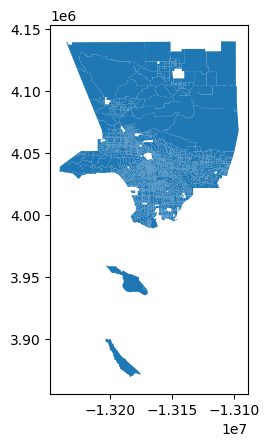

In [135]:
vul.plot()

In [136]:
vul = vul.to_crs(4326)

In [137]:
## We join our spatial data together with our census tract
vul_neighborhoods = vul.sjoin(neighborhoods, how='left')
vul_neighborhoods.FIPS.value_counts()

FIPS
06037980010    6
06037262200    5
06037187102    5
06037269000    5
06037132700    5
              ..
06037403600    1
06037403500    1
06037403408    1
06037403407    1
06037404302    1
Name: count, Length: 2315, dtype: int64

In [138]:
## We keep certain columns that we might want to look at in maps later and also rename them for legibility
vul_neighborhoods = vul_neighborhoods[[
 'geometry',
 'FIPS',
 'name',
 'LOCATION',
 'AREA_SQMI',
 'E_TOTPOP',
 'E_HU',
 'E_HH',
 'E_POV',
 'E_UNEMP',
 'E_PCI',
 'E_NOHSDP',
 'E_AGE65',
 'E_AGE17',
 'E_DISABL',
 'E_SNGPNT',
 'E_MINRTY',
 'E_LIMENG',
 'E_MUNIT',
 'E_MOBILE',
 'E_CROWD',
 'E_NOVEH',
 'E_GROUPQ',
 'EP_POV',
 'EP_UNEMP',
 'EP_PCI',
]].copy()

vul_neighborhoods = vul_neighborhoods.rename(columns={
 'LOCATION':'location',
 'AREA_SQMI':'area_sqmile',
 'E_TOTPOP':'total_pop',
 'E_HU':'housing_units',
 'E_HH':'households',
 'E_POV':'pct_below150',
 'E_UNEMP':'unemployed',
 'E_PCI':'cost_burdened_low_income',
 'E_NOHSDP':'no_high_school',
 'E_AGE65':'persons_over65',
 'E_DISABL':'disabled_pop',
 'E_SNGPNT':'single_parent',
 'E_MINRTY':'minority_pop',
 'E_LIMENG':'limited_eng',
 'E_MUNIT':'10_units_plus',
 'E_CROWD':'crowded_units',
 'E_GROUPQ':'persons_group_quarters',
 'EP_POV':'pct_pov',
 'EP_UNEMP':'pct_unemp',
 'EP_PCI':'pct_cost_burdened_low_income',
})
vul_neighborhoods.head()

,geometry,FIPS,name,location,area_sqmile,total_pop,housing_units,households,pct_below150,unemployed,...,minority_pop,limited_eng,10_units_plus,E_MOBILE,crowded_units,E_NOVEH,persons_group_quarters,pct_pov,pct_unemp,pct_cost_burdened_low_income
0,"POLYGON ((-118.30077 34.25961, -118.30077 34.2...",06037101110,Tujunga,"Census Tract 1011.10, Los Angeles County, Cali...",0.441084,4314,1743,1596,679,166,...,1798,425,220,29,82,123,95,16.1,7.7,26996
1,"POLYGON ((-118.30321 34.27334, -118.29971 34.2...",06037101122,Sunland,"Census Tract 1011.22, Los Angeles County, Cali...",1.020871,3239,1391,1256,109,94,...,484,127,0,0,62,7,5,3.4,4.6,46974
1,"POLYGON ((-118.30321 34.27334, -118.29971 34.2...",06037101122,Tujunga,"Census Tract 1011.22, Los Angeles County, Cali...",1.020871,3239,1391,1256,109,94,...,484,127,0,0,62,7,5,3.4,4.6,46974
2,"POLYGON ((-118.29946 34.25598, -118.29106 34.2...",06037101210,Tujunga,"Census Tract 1012.10, Los Angeles County, Cali...",0.251233,6052,2402,2321,1994,321,...,3061,1032,1425,0,285,287,65,33.0,10.1,19902
3,"POLYGON ((-118.28594 34.25228, -118.28594 34.2...",06037101220,Tujunga,"Census Tract 1012.20, Los Angeles County, Cali...",0.269841,3497,1328,1294,524,132,...,1803,647,339,0,152,113,0,15.0,7.8,21844


#### Map of census tracts with various characteristics

In [146]:
to_map = ['limited_eng','cost_burdened_low_income','minority_pop','disabled_pop','10_units_plus']

for i in to_map:
    m2 = fm.Map(location=[34.2,-118.2], 
                zoom_start = 10,
                tiles='CartoDB positron', 
                attribution='CartoDB')
        # plot chorpleth over the base map
    fm.Choropleth(
            geo_data=vul_neighborhoods, # geo data
            data=vul_neighborhoods, # data          
            key_on='feature.properties.FIPS', # key, or merge column
            columns=['FIPS', i], # [key, value]
            fill_color='OrRd',
            nan_fill_color='grey',
            nan_fill_opacity=0.4,
            line_weight=0.1, 
            fill_opacity=0.3,
            line_opacity=0.2,
        ).add_to(m2) 
    display(m2)   

### We create a new dataframe that summarizes the eviction data into counts per census tract

In [ ]:
address_ct = mergedevictions['Address_x'].value_counts().reset_index(name='count')
address_df = address_ct.merge(mergedevictions,how='left',on='Address_x')
address_df = address_df.drop_duplicates(subset='Address_x')
address_df.Address_x.value_counts()
address_df = gpd.GeoDataFrame(address_df, geometry='geometry')
address_df.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 12588 entries, 0 to 64905
Data columns (total 24 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   Address_x          12588 non-null  object        
 1   count              12588 non-null  int64         
 2   Unnamed: 0         12588 non-null  int64         
 3   latitude           12588 non-null  float64       
 4   longitude          12588 non-null  float64       
 5   accuracy           12588 non-null  object        
 6   google_place_id    12588 non-null  object        
 7   type               12588 non-null  object        
 8   zipcode            12588 non-null  int64         
 9   input_string       12588 non-null  object        
 10  number_of_results  12588 non-null  int64         
 11  status             12588 non-null  object        
 12  Notice Date        12588 non-null  object        
 13  Date Received      12588 non-null  object        
 14  Evi

In [ ]:
evictions_address = address_df.sjoin(vul_neighborhoods,how='right')
evictions_address.columns.to_list()
evictions_address.geometry
evictions_address=evictions_address.drop_duplicates(subset = 'Address_x')
evictions_address.Address_x = evictions_address.Address_x.astype(str)

In [ ]:
census_evic_counts = evictions_address.groupby('FIPS').agg({
 'Address_x':', '.join,
 'count':'sum',
 'zipcode':'first',
 'geometry':'first',
 'name':'first',
 'location':'first',
 'area_sqmile':'first',
 'total_pop':'first',
 'housing_units':'first',
 'households':'first',
 'pct_below150':'first',
 'unemployed':'first',
 'cost_burdened_low_income':'first',
 'no_high_school':'first',
 'persons_over65':'first',
 'disabled_pop':'first',
 'single_parent':'first',
 'minority_pop':'first',
 'limited_eng':'first',
 '10_units_plus':'first',
 'crowded_units':'first',
 'persons_group_quarters':'first',
 'pct_pov':'first',
 'pct_unemp':'first',
 'pct_cost_burdened_low_income':'first'
}).reset_index()

In [ ]:
census_evic_counts.head()

,FIPS,Address_x,count,zipcode,geometry,name,location,area_sqmile,total_pop,housing_units,...,disabled_pop,single_parent,minority_pop,limited_eng,10_units_plus,crowded_units,persons_group_quarters,pct_pov,pct_unemp,pct_cost_burdened_low_income
0,06037101110,"10346 Commerce Ave, Tujunga, CA 91042, USA, 10...",3.0,91042.0,"POLYGON ((-118.30077 34.25961, -118.30077 34.2...",Tujunga,"Census Tract 1011.10, Los Angeles County, Cali...",0.441084,4314,1743,...,521,121,1798,425,220,82,95,16.1,7.7,26996
1,06037101122,"11474 Dellmont Dr, Tujunga, CA 91042, USA, 106...",6.0,91042.0,"POLYGON ((-118.30321 34.27334, -118.29971 34.2...",Sunland,"Census Tract 1011.22, Los Angeles County, Cali...",1.020871,3239,1391,...,354,99,484,127,0,62,5,3.4,4.6,46974
2,06037101210,"10240 Commerce Ave, Tujunga, CA 91042, USA, 10...",32.0,91042.0,"POLYGON ((-118.29946 34.25598, -118.29106 34.2...",Tujunga,"Census Tract 1012.10, Los Angeles County, Cali...",0.251233,6052,2402,...,1041,370,3061,1032,1425,285,65,33.0,10.1,19902
3,06037101220,"7047 Greeley St, Tujunga, CA 91042, USA, 10165...",12.0,91042.0,"POLYGON ((-118.28594 34.25228, -118.28594 34.2...",Tujunga,"Census Tract 1012.20, Los Angeles County, Cali...",0.269841,3497,1328,...,583,133,1803,647,339,152,0,15.0,7.8,21844
4,06037101300,"11886 W Foothill Blvd, Tujunga, CA 91042, USA,...",25.0,91042.0,"POLYGON ((-118.27824 34.25166, -118.27693 34.2...",Shadow Hills,"Census Tract 1013, Los Angeles County, California",0.996612,4297,1584,...,605,40,794,194,36,34,47,9.2,5.7,35120


In [ ]:
census_evic_counts = gpd.GeoDataFrame(census_evic_counts,geometry='geometry')

In [ ]:
census_evic_counts_top = census_evic_counts.nlargest(100,columns='count')
census_evic_counts_bottom = census_evic_counts.nsmallest(100,columns='count')

In [ ]:
census_evic_counts_bottom.crs = "EPSG:4326"
census_evic_counts_top.crs = "EPSG:4326"

### Map Single Parent Households with Highest Eviction Filings

In [92]:
m = fm.Map(location=[34.2,-118.2], 
               zoom_start = 10,
               tiles='CartoDB positron', 
               attribution='CartoDB')

# plot chorpleth over the base map
fm.Choropleth(
    geo_data=census_evic_counts_top, # geo data
    data=census_evic_counts_top, # data          
    key_on='feature.properties.FIPS', # key, or merge column
    columns=['FIPS', 'single_parent'], # [key, value]
    fill_color= 'OrRd' ,
    nan_fill_color='grey',
    nan_fill_opacity=0.4,
    line_weight=0.1, 
    fill_opacity=0.4,
    line_opacity=0.2,
    title='Single Parent Households in Census Tracts with Highest Eviction Filings',    
).add_to(m)  
m

In [93]:
m = fm.Map(location=[34.2,-118.2], 
               zoom_start = 10,
               tiles='CartoDB positron', 
               attribution='CartoDB')

# plot chorpleth over the base map
fm.Choropleth(
    geo_data=census_evic_counts_top, # geo data
    data=census_evic_counts_top, # data          
    key_on='feature.properties.FIPS', # key, or merge column
    columns=['FIPS', 'crowded_units'], # [key, value]
    fill_color= 'OrRd' ,
    nan_fill_color='grey',
    nan_fill_opacity=0.4,
    line_weight=0.1, 
    fill_opacity=0.4,
    line_opacity=0.2,
    title='Crowded Units in Census Tracts with Highest Eviction Filings',    
).add_to(m)  
m

### Map Top and Bottom Census Tracts with SVI Choropleth

In [94]:
m = fm.Map(location=[34.2,-118.2], 
               zoom_start = 10,
               tiles='CartoDB positron', 
               attribution='CartoDB')

# plot chorpleth over the base map
fm.Choropleth(
    geo_data=census_evic_counts_top, # geo data
    data=census_evic_counts_top, # data          
    key_on='feature.properties.FIPS', # key, or merge column
    columns=['FIPS', 'cost_burdened_low_income'], # [key, value]
    fill_color='BuPu',
    nan_fill_color='grey',
    nan_fill_opacity=0.4,
    line_weight=0.1, 
    fill_opacity=0.8,
    line_opacity=0.2,
    title='Rent Burden in Census Tracts with Highest Eviction Filings',    
).add_to(m)  
m

In [95]:
m = fm.Map(location=[34.2,-118.2], 
               zoom_start = 10,
               tiles='CartoDB positron', 
               attribution='CartoDB')

# plot chorpleth over the base map
fm.Choropleth(
    geo_data=census_evic_counts_bottom, # geo data
    data=census_evic_counts_bottom, # data          
    key_on='feature.properties.FIPS', # key, or merge column
    columns=['FIPS', 'pct_cost_burdened_low_income'], # [key, value]
    fill_color='BuPu',
    nan_fill_color='grey',
    nan_fill_opacity=0.4,
    line_weight=0.1, 
    fill_opacity=0.8,
    line_opacity=0.2,
    title='Rent Burden in Census Tracts with Least Eviction Filings',    
).add_to(m)  
m

In [96]:
neigh_count_df = evictions_address.groupby('name').agg({'count':'sum'})
neigh_top = neigh_count_df.nlargest(15,columns='count')

neigh_bottom = neigh_count_df.nsmallest(15,columns='count')
neigh_top.columns

Index(['count'], dtype='object')

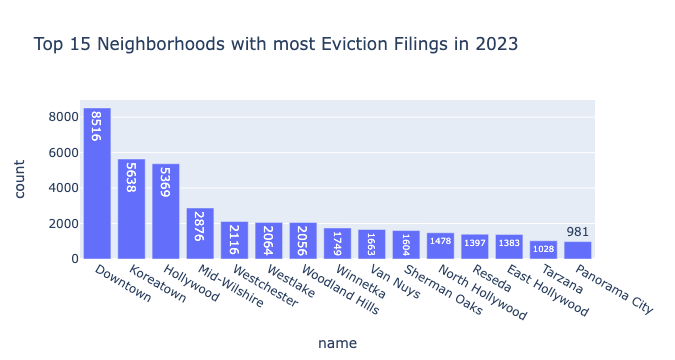

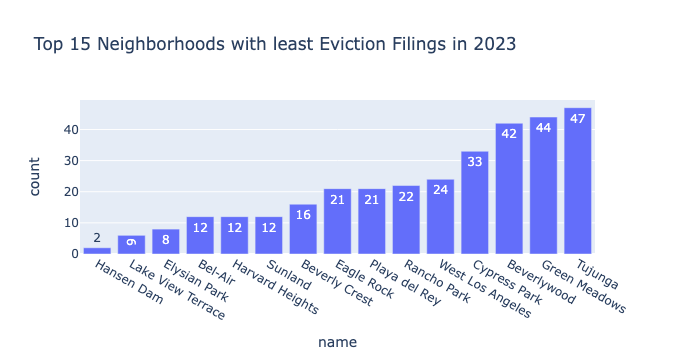

In [97]:
# I'm interested in seeing if there are particular buildings with high rates of evictions
fig_top = px.bar(
    neigh_top,
    x=neigh_top.index,
    y='count',
    title='Top 15 Neighborhoods with most Eviction Filings in 2023',
    text='count'
)
fig_bottom = px.bar(
    neigh_bottom,
    x=neigh_bottom.index,
    y='count',
    title='Top 15 Neighborhoods with least Eviction Filings in 2023',
    text='count'
)
fig_top.show()
fig_bottom.show()

Our analysis of top 15 neighborhoods with high eviction rates versus neighborhoods with low eviction rates show that Downtown LA, Koreatown, and Hollywood have the highest eviction rates. The bottom 15 neighboorhoods show that Hansen Dam, Lake View Terrace, and Elysian Park have the least eviction numbers. When we compare these cities we notice that the bottom neighborhoods have high median income compared to the top 15 neighborhoods with high eviction rates. 

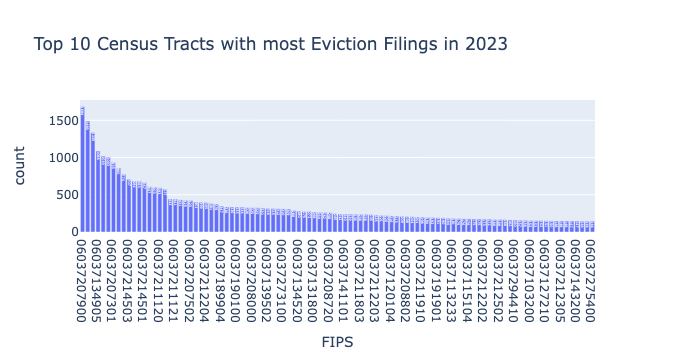

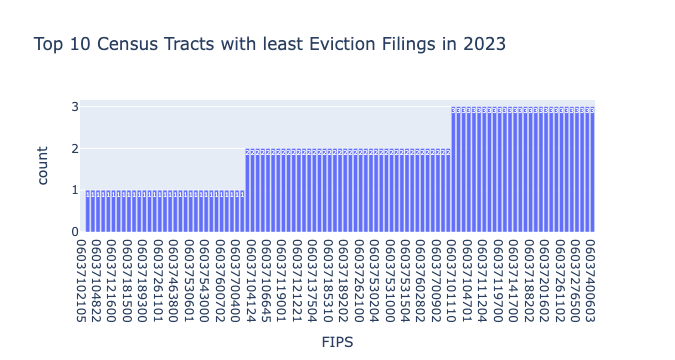

In [98]:
fig_top = px.bar(
    census_evic_counts_top,
    x='FIPS',
    y='count',
    title='Top 10 Census Tracts with most Eviction Filings in 2023',
    text='count'
)
fig_bottom = px.bar(
    census_evic_counts_bottom,
    x='FIPS',
    y='count',
    title='Top 10 Census Tracts with least Eviction Filings in 2023',
    text='count'
)
fig_top.show()
fig_bottom.show()

## Group members and Division of Labor: 
Kristal Ombogo: Worked on part 1, focusing on the overall spatial analysis of homeownership, creating charts, and interactive maps. Kristal also cleaned up the final notebook, coordinated submission, and laid out the slides for the presentation of the data.

Jack Fukushima: Focused on the third part of the project, zooming into the demographic and socioeconomic characteristics of specific census tracts in LA with low eviction rates. Jack also cleaned up a significant portion of the dataset on evictions, including geocoding the addresses to facilitate mapping.

Roberto Diaz: Contributed to visualizing the demographic and socioeconomic characteristics of specific census tracts in LA, particularly those with high eviction rates.

Daisy Mugodzeri: TBD. Presented findings and next steps. 